# Stacking daily profiles before calculating velocities
Using same methods and settings from `method_across_seasons`. 

In [1]:
# Load libraries
import sys
import sys
sys.path.append("../../../xapres_package/")
import ApRESDefs
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker 
import pickle

import xarray as xr
import importlib
import pandas as pd
import math
from datetime import datetime, timedelta, date
from scipy.stats import linregress
from helpers import *

importlib.reload(ApRESDefs)
xa = ApRESDefs.xapres(loglevel='debug')

DEBUG    21:51:21 	 ApRESDefs.py @function _setup_logging line 615 - Stream logging level set to DEBUG
DEBUG    21:51:21 	 ApRESDefs.py @function _setup_logging line 616 - Add console handler to logger
DEBUG    21:51:21 	 ApRESDefs.py @function _setup_logging line 629 - File logging level set to DEBUG


In [15]:
# helper functions
def shift_profile_range(profiles,shift_value):
    profiles_adjust = profiles.where(profiles.profile_range > shift_value, drop = True)
    profiles_adjust['profile_range'] = profiles_adjust.profile_range - shift_value
    return profiles_adjust

def strain_metrics(ds, win_cor, step, lag, noise_floor,bin_adjust=1):
    # This function, given a window, and step, gives a total percentage of data that has high coherence
    b1 = ds.isel(time=range(0,len(ds)-lag))
    b2 = ds.isel(time=range(lag,len(ds)))
    dz, co, phi = xa.generate_range_diff(b1,b2,win_cor,step,None,0,0.95)
    dz=dz.assign(coherence=(['time','profile_range'],co))
    dz_new = dz.where(abs(dz.coherence) > 0.95).drop_duplicates('time')

    vv = dz_new.range_diff / dz_new.time_diff * 31536000
    vv_adjust = vv - vv.isel(profile_range = range(0,bin_adjust)).mean(dim='profile_range')
    vv_err = dz_new.err / dz_new.time_diff * 31536000
    vv_mean_err = (vv_err.isel(profile_range = range(0,bin_adjust))**2).sum(dim='profile_range')/bin_adjust
    vv_adjust_err = np.sqrt(vv_err**2 + vv_mean_err)

    #fit=vv.where(vv.profile_range <=noise_floor).polyfit('profile_range',1,full=True)
    fit=vv.where(vv.profile_range <=noise_floor).polyfit('profile_range',1,full=True)
    r2 = 1-fit.polyfit_residuals/((vv.where(vv.profile_range <=noise_floor)-vv.where(vv.profile_range <=noise_floor).mean())**2).sum(dim='profile_range')
    
    slope = fit.polyfit_coefficients.sel(degree=1)*vv.profile_range+fit.polyfit_coefficients.sel(degree=0)
    residual = vv-slope
    residual = residual.where(residual.profile_range <=noise_floor,drop=True)
    slope_errs = np.sqrt((1/(len(residual.profile_range)-2))*(((residual**2).sum(dim='profile_range'))/((residual.profile_range - residual.profile_range.mean())**2).sum()))

    int_err = slope_errs*np.sqrt(((vv.profile_range)**2).sum()/len(vv.profile_range))
    ds = vv.to_dataset(name='vv')
    ds['err'] = vv_err
    ds['slope']= fit.polyfit_coefficients.sel(degree=1)
    ds['intercept']=fit.polyfit_coefficients.sel(degree=0)
    ds['fit'] = slope
    ds['slope_err'] = slope_errs
    ds['int_err'] = int_err
    ds['vv_adjust'] = vv_adjust
    ds['vv_adjust_err'] = vv_adjust_err
    ds['doy_decimal'] =  ds.time.dt.dayofyear + (ds.time.dt.hour / 24) + (ds.time.dt.minute / 1440) + (ds.time.dt.second / 86400)
    return ds
    
def plot_fits(ds_array,label_array,doy=False):
    fig, axs = plt.subplots(nrows=1,figsize=(15,6),sharex=True)
    for i in range(len(ds_array)):
        ds = ds_array[i]
        if doy:
            axs.errorbar(ds.doy_decimal,ds.slope,yerr=ds.slope_err,marker='.',label = label_array[i])
            axs.set_xlabel('DOY')
        else:
            axs.errorbar(ds.time.values,ds.slope,yerr=ds.slope_err,marker='.',label = label_array[i])
    axs.axhline(color='k',linestyle='--',zorder=3)
    axs.legend()
    axs.set_ylabel('Strain rate [y$^{-1}$]')
    axs.set_title('Strain rate estimates')
    
    

def convert_to_doy(da):
    da['doy_decimal'] = da.time.dt.dayofyear + (da.time.dt.hour / 24) + (da.time.dt.minute / 1440) + (da.time.dt.second / 86400)
    return da

def animate_vv(vv):
    # ok it looks like the oscillations are due to a fitting  artifact
    import matplotlib.pyplot as plt
    import matplotlib.animation
    import numpy as np
    
    
    fig,axs = plt.subplots(figsize=(15, 10),nrows = 2)
    
    
    times = vv.time.values
    strain = axs[0].errorbar(vv.time.values,vv.slope,yerr=vv.slope_err,marker='.')
    #ax4.set_yscale('symlog', linthresh=0.1)
    axs[0].set_xlabel('DOY 2022')
    axs[0].set_ylabel('strain rate [y$^{-1}$]')
    time_line = axs[0].axvline(times[0],color = 'black',linestyle = '--')
    title_str = str(vv.time.values[0])[:16].replace('T',' ')
    axs[0].set_title(f'Time = {title_str}')
    
    axs[1].errorbar(vv.profile_range,vv.vv.isel(time=0),yerr=vv.err.isel(time=0),linestyle='None',marker='.',color = 'tab:blue')
    axs[1].plot(vv.profile_range.where(vv.profile_range<600),vv.fit.isel(time=0).where(vv.profile_range<600),color='k')
    axs[1].set_ylim([-10,10])
    
    def animate(i):
        i = 5*i
        time_line.set_xdata([times[i],times[i]])
        title_str = str(vv.time.values[i])[:16].replace('T',' ')
        axs[0].set_title(f'Time = {title_str}')
        
        axs[1].clear()
        axs[1].errorbar(vv.profile_range,vv.vv.isel(time=i),yerr=vv.err.isel(time=i),linestyle='None',marker='.',color = 'tab:blue')
        axs[1].plot(vv.profile_range.where(vv.profile_range<600),vv.fit.isel(time=i).where(vv.profile_range<600),color='k')
    
        #axs[1].set_ylim([-10,10])
    
    
      
    
    ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(times)//5)
    
    return ani


## A11

In [4]:
# Load data
with open('../chirp_processing/A11_22S.pickle', 'rb') as handle:
    s22 = pickle.load(handle)

with open('../chirp_processing/A11_22W.pickle', 'rb') as handle:
    winter = pickle.load(handle)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

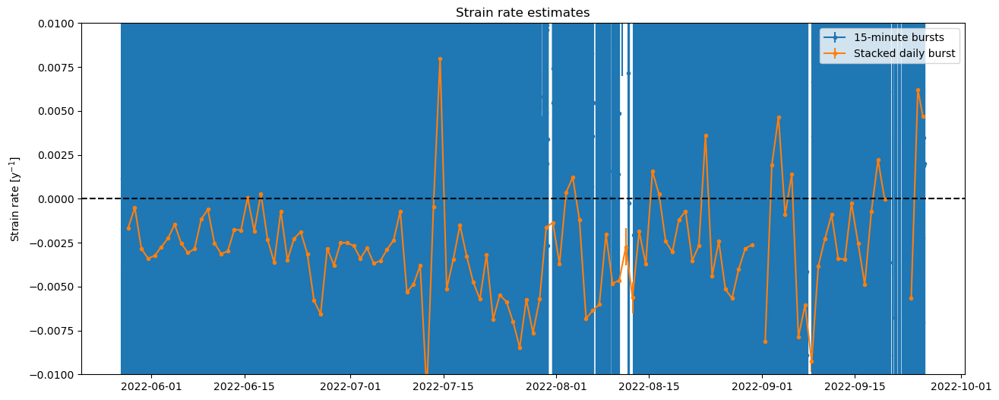

In [5]:
# all summer
time_to_interp = pd.date_range("2022-05-27 12:00", "2022-09-25 12:00", freq="15min")
interp_profiles = s22.interp(time=time_to_interp,method='linear')

interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

#a11 = strain_metrics(interp_profiles, 50, 50,1,500)
a11 = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
a11_day = strain_metrics(interp_profiles_day, 50, 50,1,500,2)

plot_fits([a11,a11_day],['15-minute bursts','Stacked daily burst'])
plt.ylim([-1e-2,1e-2])

ok 1
ok2


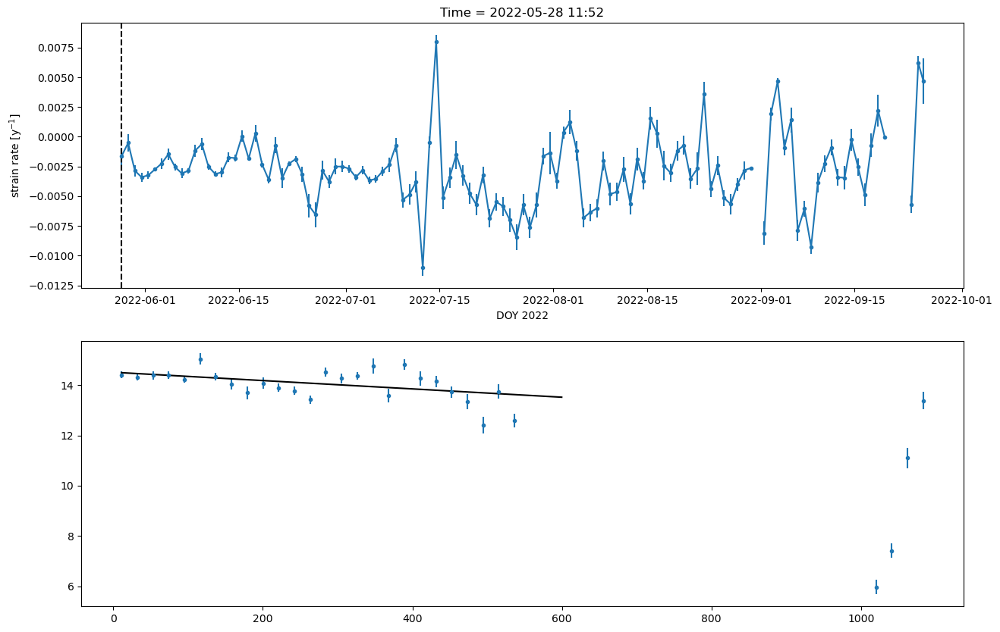

In [12]:
ani = animate_vv(a11_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

(-0.01, 0.01)

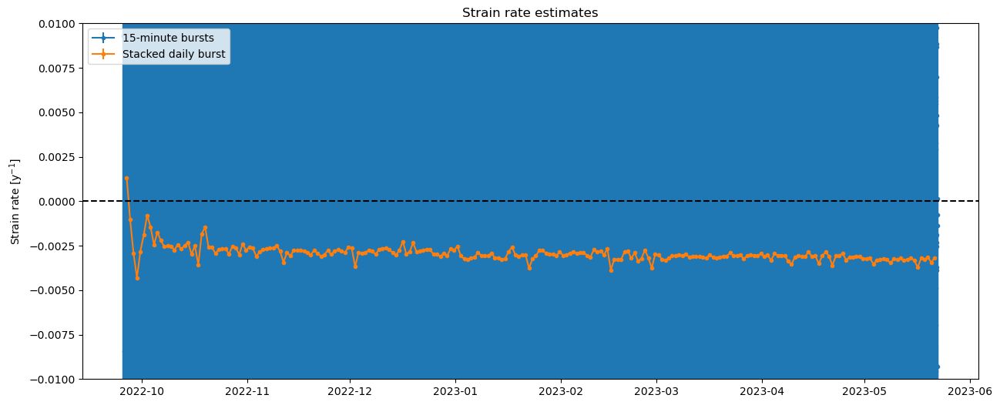

In [13]:
# all winter
time_to_interp = pd.date_range("2022-09-25 16:00", "2023-05-22 12:00", freq="15min")
interp_profiles = winter.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

#a11 = strain_metrics(interp_profiles, 50, 50,1,500)
a11 = strain_metrics(interp_profiles_adjust, 50, 50,1,500,2)
a11_day = strain_metrics(interp_profiles_day, 50, 50,1,500,2)

plot_fits([a11,a11_day],['15-minute bursts','Stacked daily burst'])
plt.ylim([-1e-2,1e-2])

ok 1
ok2


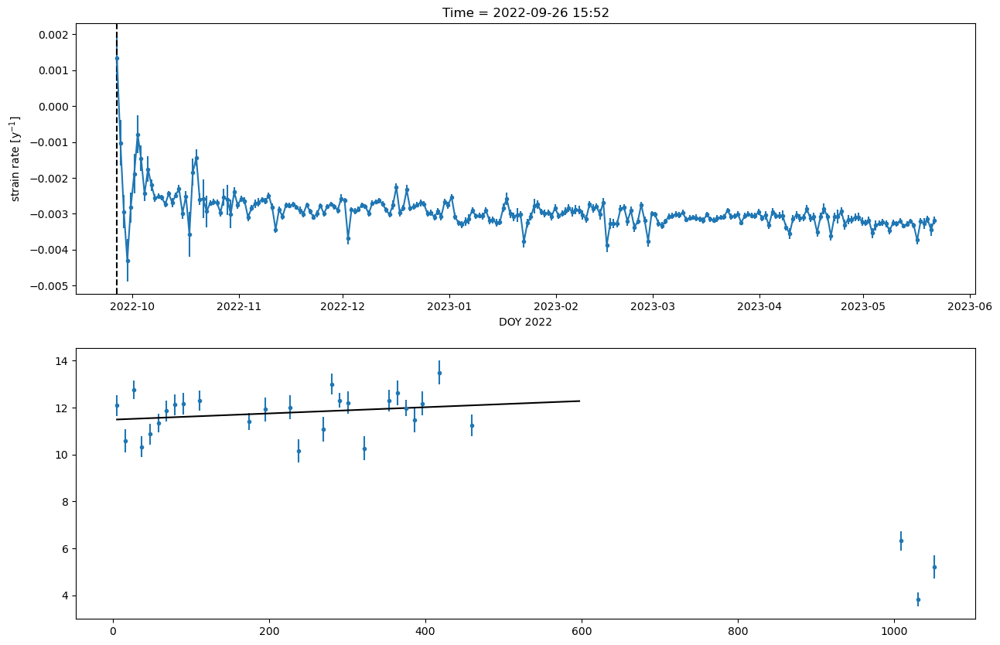

In [14]:
ani = animate_vv(a11_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

# A13

In [26]:
# Load data
with open('../chirp_processing/A13_22S.pickle', 'rb') as handle:
    s22 = pickle.load(handle)

with open('../chirp_processing/A13_22W.pickle', 'rb') as handle:
    winter = pickle.load(handle)

with open('../chirp_processing/A13_23S.pickle', 'rb') as handle:
    s23 = pickle.load(handle)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

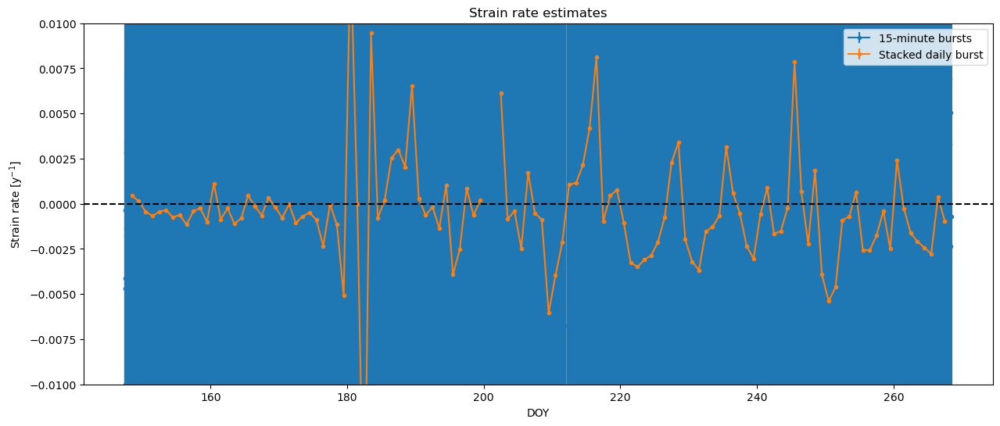

In [17]:
# all summer
time_to_interp = pd.date_range("2022-05-27 12:00", "2022-09-25 12:00", freq="15min")
interp_profiles = s22.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)
interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

a13 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_day = strain_metrics(interp_profiles_day, 24, 24,1,500,1)

plot_fits([a13,a13_day],['15-minute bursts','Stacked daily burst'],doy=True)
#plt.xlim([240,245])
plt.ylim([-1e-2,1e-2])

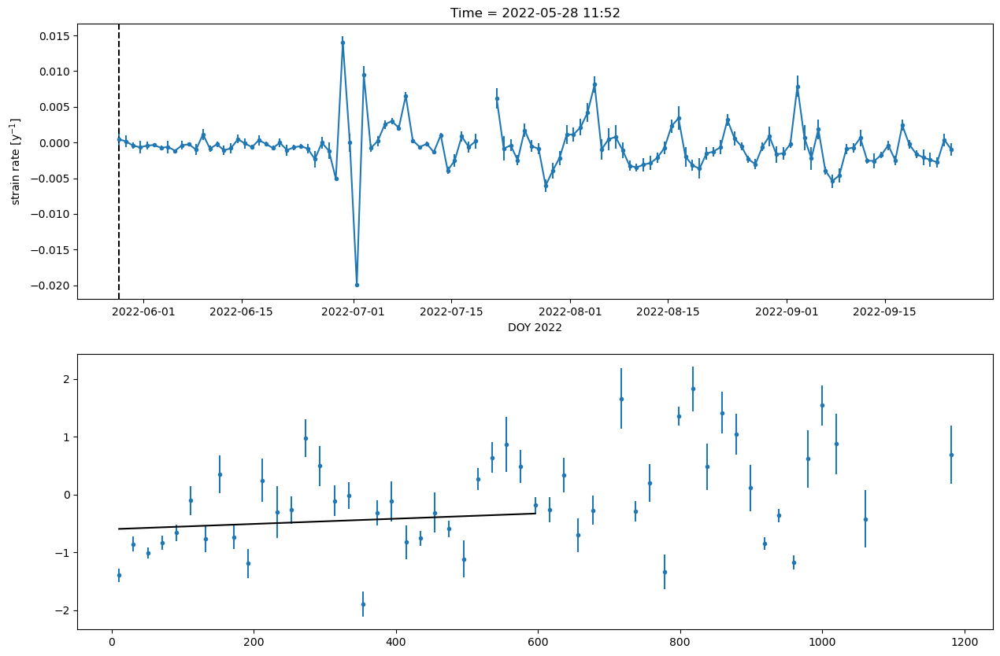

In [18]:
ani = animate_vv(a13_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.001, 0.001)

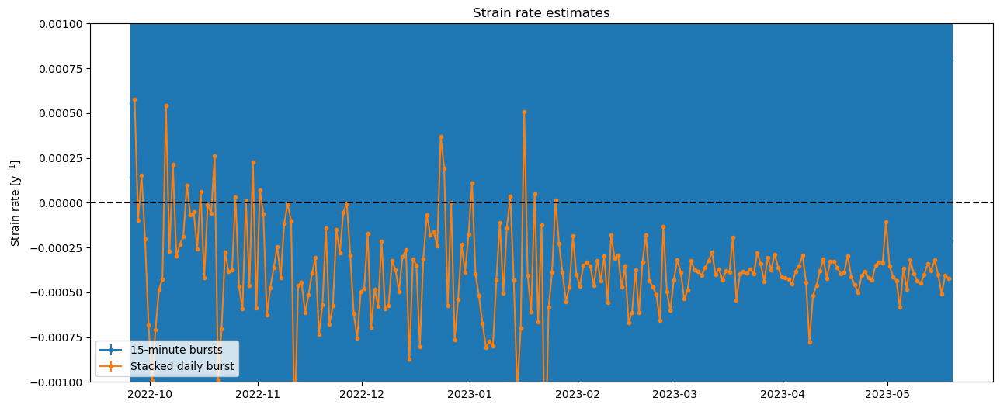

In [19]:
# all winter
time_to_interp = pd.date_range("2022-09-25 16:00", "2023-05-22 12:00", freq="15min")
interp_profiles = winter.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)
interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

a13 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_day = strain_metrics(interp_profiles_day, 24, 24,1,500,1)

plot_fits([a13,a13_day],['15-minute bursts','Stacked daily burst'])
#plt.xlim([240,245])
plt.ylim([-1e-3,1e-3])

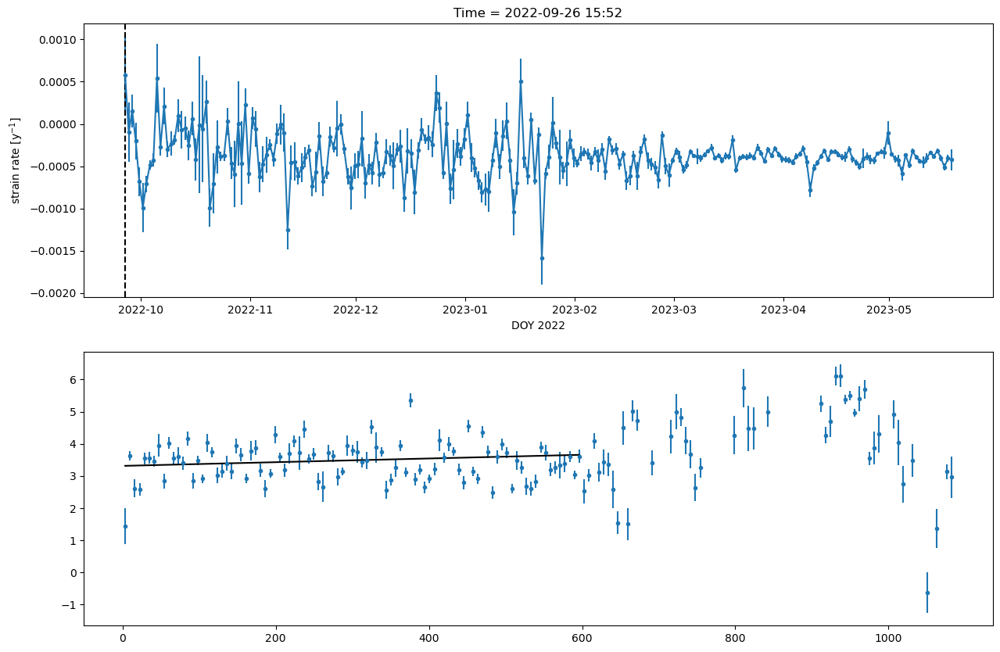

In [20]:
ani = animate_vv(a13_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

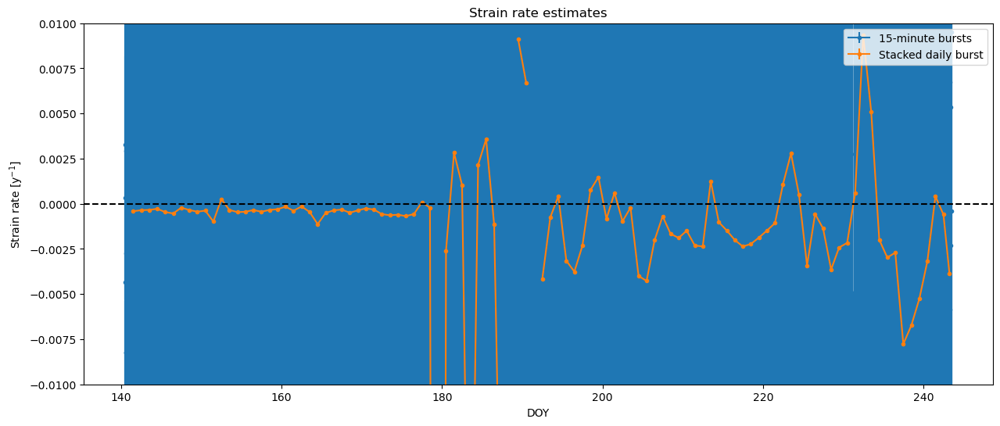

In [29]:
# all summer
time_to_interp = pd.date_range("2023-05-20 12:00", "2023-08-31 12:00", freq="15min")
interp_profiles = s23.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,25)
interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

a13 = strain_metrics(interp_profiles_adjust, 24, 24,1,500,1)
a13_day = strain_metrics(interp_profiles_day, 24, 24,1,500,1)

plot_fits([a13,a13_day],['15-minute bursts','Stacked daily burst'],doy=True)
#plt.xlim([240,245])
plt.ylim([-1e-2,1e-2])

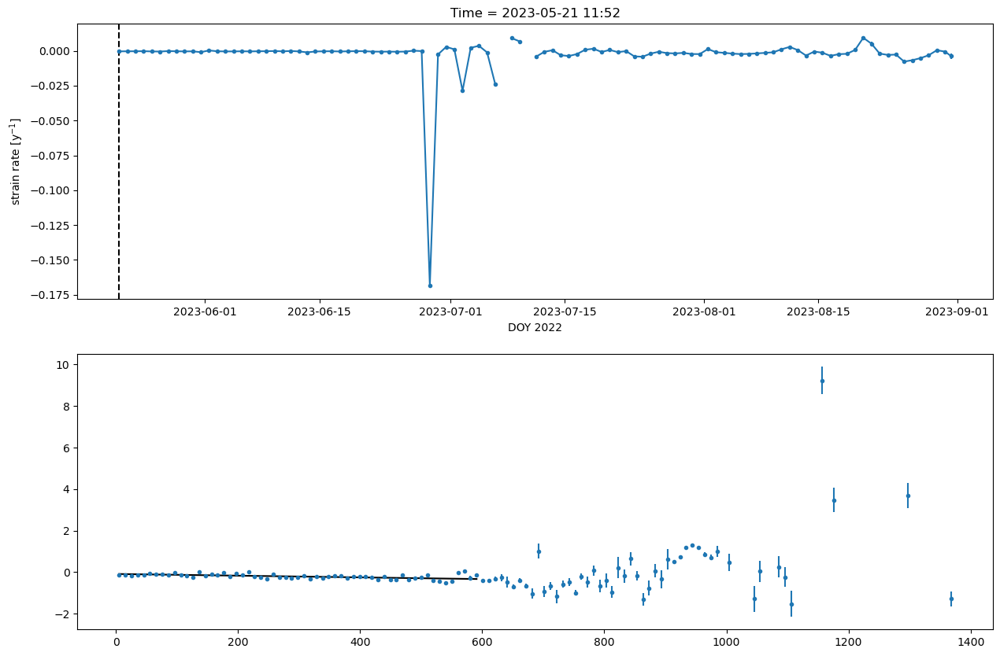

In [30]:
ani = animate_vv(a13_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

# A14

In [31]:
# Load data
with open('../chirp_processing/A14_22S.pickle', 'rb') as handle:
    s22 = pickle.load(handle)

with open('../chirp_processing/A14_22W.pickle', 'rb') as handle:
    winter = pickle.load(handle)


with open('../chirp_processing/A14_23S.pickle', 'rb') as handle:
    s23 = pickle.load(handle)

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

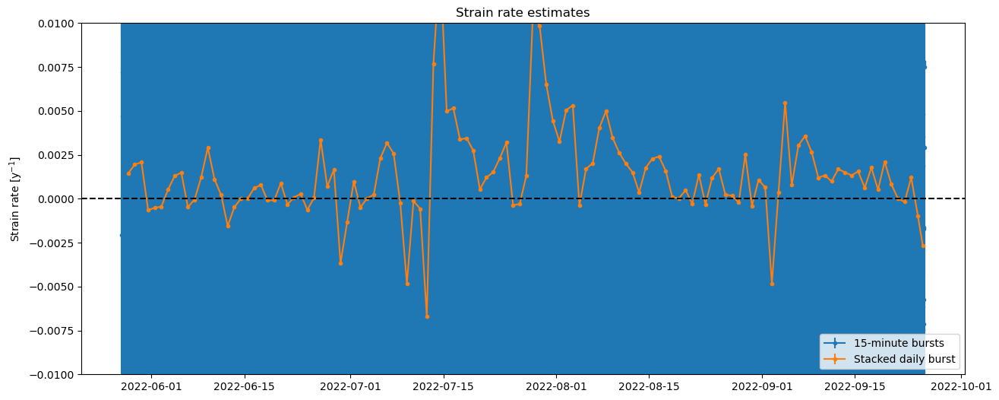

In [22]:
# all summer
time_to_interp = pd.date_range("2022-05-27 12:00", "2022-09-25 12:00", freq="15min")
interp_profiles = s22.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

a14 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_day = strain_metrics(interp_profiles_day, 80, 80,1,500,2)

plot_fits([a14,a14_day],['15-minute bursts','Stacked daily burst'])
#plt.xlim([240,245])
plt.ylim([-1e-2,1e-2])

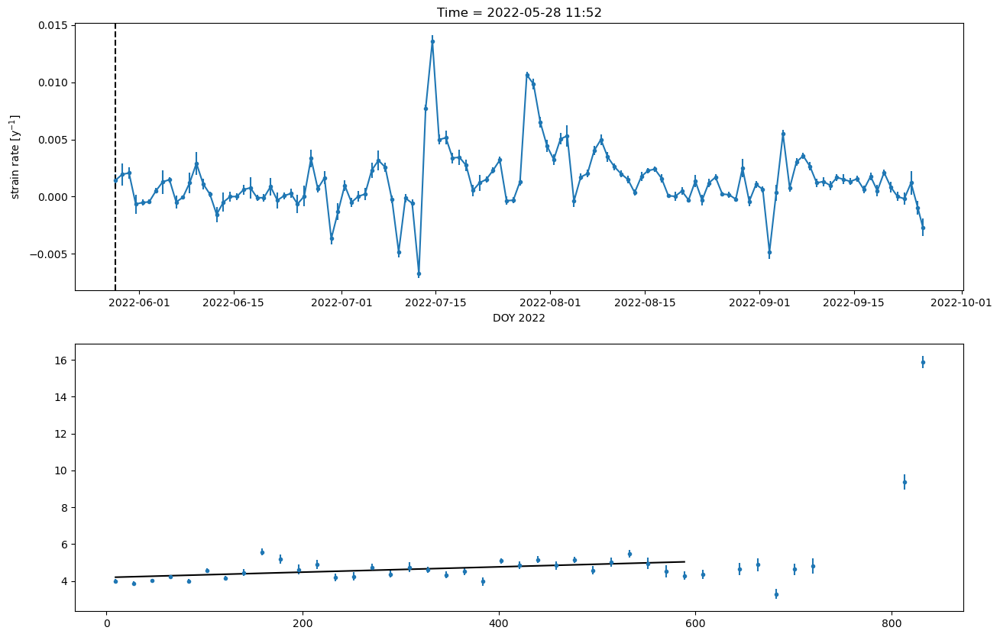

In [23]:
ani = animate_vv(a14_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom
/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.001, 0.001)

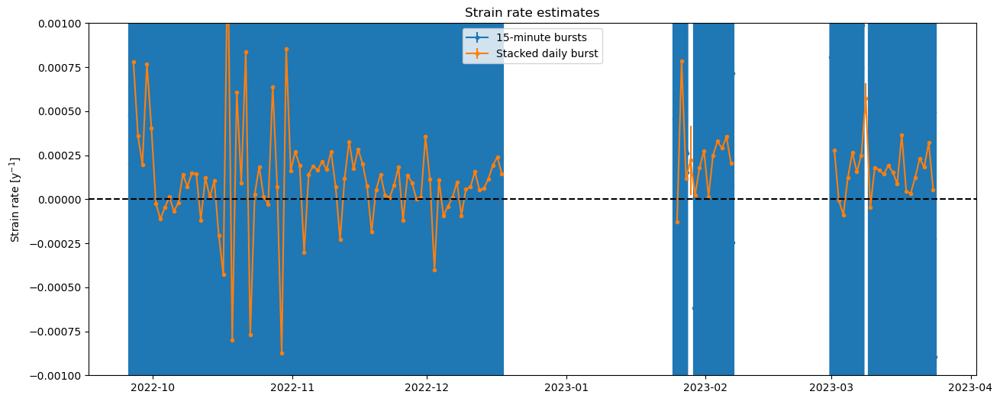

In [24]:
# all winter
time_to_interp = pd.date_range("2022-09-25 16:00", "2023-05-22 12:00", freq="15min")
interp_profiles = winter.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)
interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

a14 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_day = strain_metrics(interp_profiles_day, 80, 80,1,500,2)

plot_fits([a14,a14_day],['15-minute bursts','Stacked daily burst'])
#plt.xlim([240,245])
plt.ylim([-1e-3,1e-3])

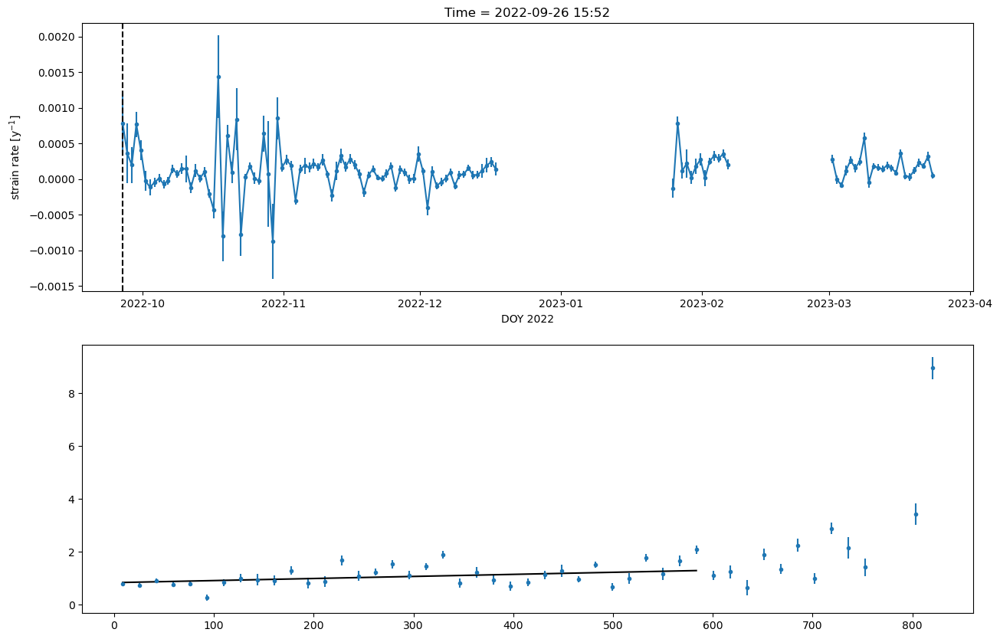

In [25]:
ani = animate_vv(a14_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())

/home/jovyan/xapres_package/notebooks/test_notes/strain_rates/../../../xapres_package/ApRESDefs.py:654: RuntimeWarning: invalid value encountered in divide
  c = top/bottom


(-0.01, 0.01)

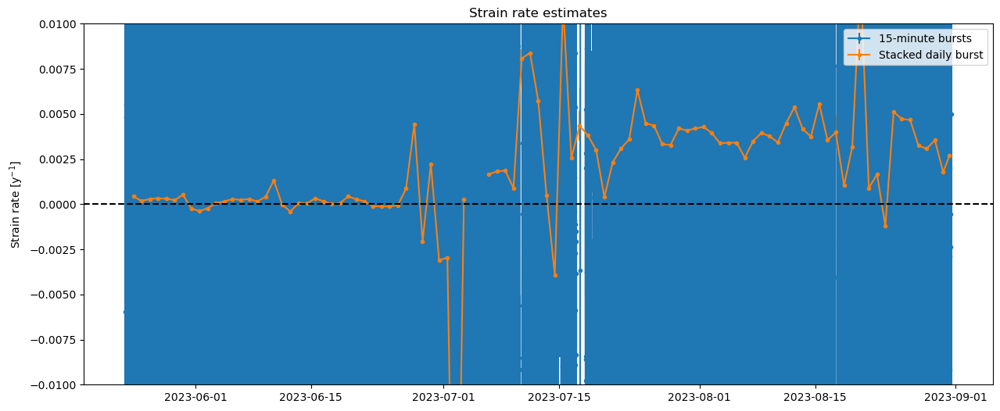

In [33]:
# all summer
time_to_interp = pd.date_range("2023-05-23 12:00", "2023-08-31 12:00", freq="15min")
interp_profiles = s23.interp(time=time_to_interp,method='linear')
interp_profiles['doy_decimal'] = interp_profiles.time.dt.dayofyear + (interp_profiles.time.dt.hour / 24) + (interp_profiles.time.dt.minute / 1440) + (interp_profiles.time.dt.second / 86400)
interp_profiles_adjust = shift_profile_range(interp_profiles,35)

interp_profiles_day = interp_profiles_adjust.coarsen(time = 96,boundary='pad').mean()

a14 = strain_metrics(interp_profiles_adjust, 80, 80,1,500,2)
a14_day = strain_metrics(interp_profiles_day, 80, 80,1,500,2)

plot_fits([a14,a14_day],['15-minute bursts','Stacked daily burst'])
#plt.xlim([240,245])
plt.ylim([-1e-2,1e-2])

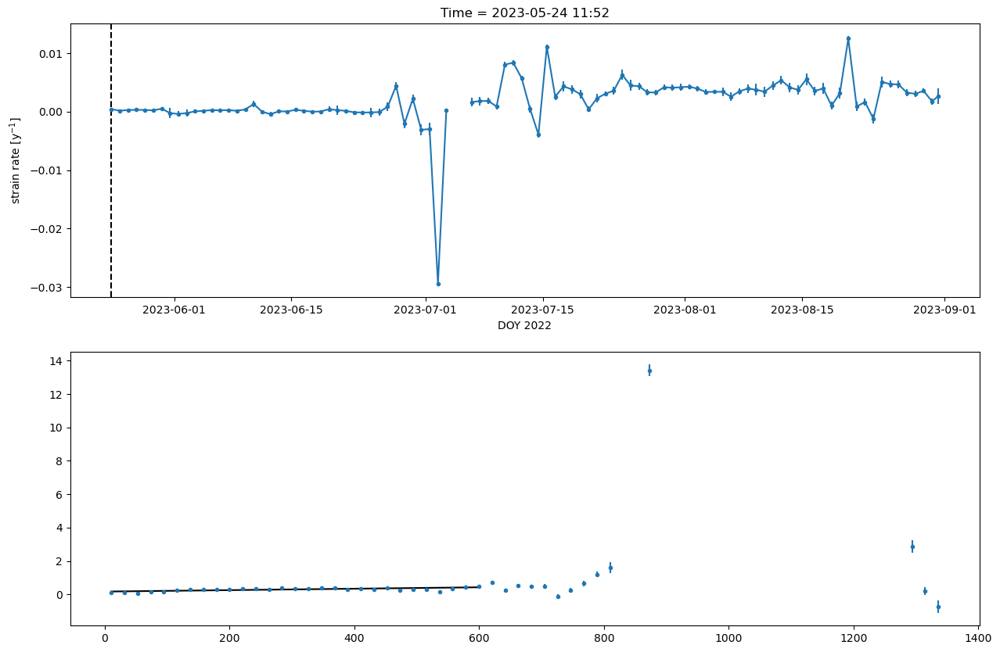

In [34]:
ani = animate_vv(a14_day)
from IPython.display import HTML
HTML(ani.to_jshtml())
#HTML(ani.to_html5_video())